# Face detection
## Machine Learning / Deep Learning
### This notebook presents some tests on face detection, using some existing open source face detection solutions / toolkits.
#### The dataset used in this example consists of images of people (mostly families) manually collected from the web.
This notebook uses Python version 3.6 or newer.

Let's start by checking the Python version.

In [1]:
import sys

if int(sys.version[0]) < 3 or int(sys.version[2]) < 6:
    assert("Python version 3.6 or newer is required")

We continue by importing the necessary libraries and toolkits.

In [2]:
from mtcnn import MTCNN
from PIL import Image
import cv2
import dlib
import gdown
import math
import numpy as np
import os
import random
import shutil
import time

np.random.seed(1531)
random.seed(1531)

2021-11-12 03:40:18.391681: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /mnt/disk/miniconda3/envs/face/lib/python3.9/site-packages/cv2/../../lib64:
2021-11-12 03:40:18.391727: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


## Data Exploration

In [3]:
def display_images(paths, image_dims=(250, 250)):
    n = len(paths)
    m = int(math.sqrt(n))
    
    minw, minh = image_dims
    collage = Image.new("RGBA", (m*minw, m*minh), color=(255,255,255,255))
    
    c = 0
    for i in range(0, m*minw, minw):
        for j in range(0, m*minh, minh):
            file = paths[c]
            photo = Image.open(file).convert("RGBA")
            photo = photo.resize((minw,minh), Image.ANTIALIAS)
            collage.paste(photo, (i, j))
            c += 1
    
    collage.show()

Let's display a collage of randomly selected samples from the dataset.

In [4]:
CUR_PATH = os.path.abspath('')
DATASET_PATH = CUR_PATH + '/dataset/original'
images = [f'{DATASET_PATH}/{f}' for f in os.listdir(DATASET_PATH) if os.path.isfile(os.path.join(DATASET_PATH, f))]
print(f"Number of images in dataset: {len(images)}")

Number of images in dataset: 62


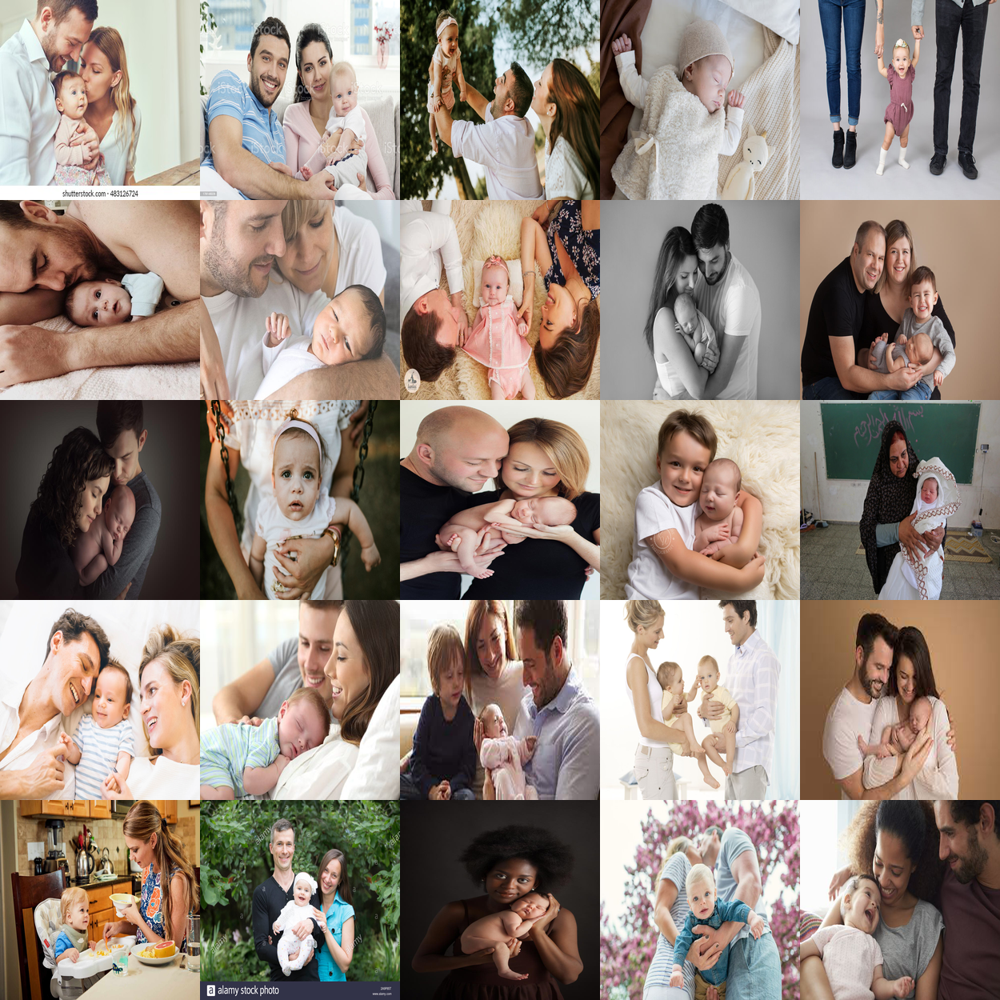

In [5]:
display = random.sample(images, min(len(images), 25))
display_images(display)

## Experimentation

In the following sections we are going to experiment with the face detectors. We are going to test the following 6 face detection models
* **OpenCV Haar cascade Face Detector**
* **OpenCV DNN Face Detector**
* **HOG + Linear SVM Face Detector**
* **MMOD + CNN Face Detector**
* **MTCNN**
* **YOLOFace (YOLOv3)**
* **YOLOv5**

and evaluate them based on
* **Total detection time**
* **Total number of faces detected**

In every experiment the detected faces are extracted as independent images and stored in the respective experiment directory.

Furthermore, the bounding boxes of the face area are drawn on the images and then the processed images are stored in the respective experiment directory.

Let's define some functions, parameters and variables which will be used in all experiments.

In [6]:
# Draw the predicted bounding box
def draw_prediction(frame, conf, left, top, right, bottom):
    # Draw a bounding box.
    colors = tuple(np.random.randint(1, 255, 3).tolist())
    cv2.rectangle(frame, (left, top), (right, bottom), colors, 2)
    
    if conf is not None:
        text = '{:.2f}'.format(conf)
        
        # Display the label at the top of the bounding box
        label_size, base_line = cv2.getTextSize(text, cv2.FONT_HERSHEY_SIMPLEX, 0.5, 1)
        
        top = max(top, label_size[1])
        cv2.putText(frame, text, (left, top - 4), cv2.FONT_HERSHEY_SIMPLEX, 0.4, colors, 1)

In [7]:
UPSCALE_FACTOR = 0
CONF_THRESHOLD = 0.5
NMS_THRESHOLD = 0.4
IMG_WIDTH = 416
IMG_HEIGHT = 416
MIN_FACE_WIDTH = 10
MIN_FACE_HEIGHT = 10

In [8]:
detector_names = []
detection_times = []
face_counts = []

# OpenCV Haar cascade Face Detector

#### This is a very old, classic and simple straight face detection algorithm, implemented in OpenCV which provides a pre-trained model.

The concept of this model is the use of Cascade of Classifiers. Instead of applying all 6000 image features on a 24x24 window, the features are grouped into different stages of classifiers and applied one-by-one. (Normally the first few stages will contain very many fewer features).

If a window fails the first stage, in which it considers the area as a non-face part of image, discard it so we don't consider the remaining features on it.

If it passes, apply the second stage of features and continue the process. The window which passes all stages is a face region.

You can find more details on this detector in the following URL:
https://docs.opencv.org/3.4/db/d28/tutorial_cascade_classifier.html

Let's define some functions, parameters and variables which will be used in this experiment.

In [9]:
FACES_PATH = CUR_PATH + '/faces_haar'
DETECTED_PATH = CUR_PATH + '/detected_haar'

# create directories for output
os.makedirs(FACES_PATH, exist_ok=True)
os.makedirs(DETECTED_PATH, exist_ok=True)

In [10]:
def post_process_haar(frame, bboxes):
    frame_height = frame.shape[0]
    frame_width = frame.shape[1]
    
    final_boxes = []
    
    for box in bboxes:
        left, top = max(box[0], 0), max(box[1], 0)
        width, height = min(box[2], frame_width - left), min(box[3], frame_height - top)
        
        final_boxes.append((left, top, width, height))
    
    return final_boxes

Let's load the model.

In [11]:
detector = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalcatface.xml')

Now let's run the experiment.

In [12]:
count = 0
elapsed = 0

for image in images:
    cap = cv2.VideoCapture(image)
    _, frame = cap.read()
    cap.release()
    
    start = time.time()
    bboxes = detector.detectMultiScale(frame, minNeighbors=3, minSize=(MIN_FACE_WIDTH, MIN_FACE_HEIGHT))
    elapsed += time.time() - start
    
    if len(bboxes) > 0:
        bboxes = post_process_haar(frame, bboxes)
        
        for box in bboxes:
            cropped = frame[box[1]:box[1]+box[3],box[0]:box[0]+box[2]]
            cv2.imwrite(f'{FACES_PATH}/face_{count:0>3}.jpg', cropped, [cv2.IMWRITE_JPEG_QUALITY, 100])
            count += 1
        
        for box in bboxes:
            draw_prediction(frame, None, box[0], box[1], box[0] + box[2], box[1] + box[3])
        
        cv2.imwrite(f"{DETECTED_PATH}/{image.split('/')[-1].split('.')[0]}.jpg", frame, [cv2.IMWRITE_JPEG_QUALITY, 100])

print(f"Elapsed time (sec): {elapsed}")
print(f"Number of faces detected: {count}")

Elapsed time (sec): 10.236938238143921
Number of faces detected: 26


In [13]:
detector_names.append("OpenCV Haar cascade Face Detector")
detection_times.append(elapsed)
face_counts.append(count)

Let's take a look at the face dection result.

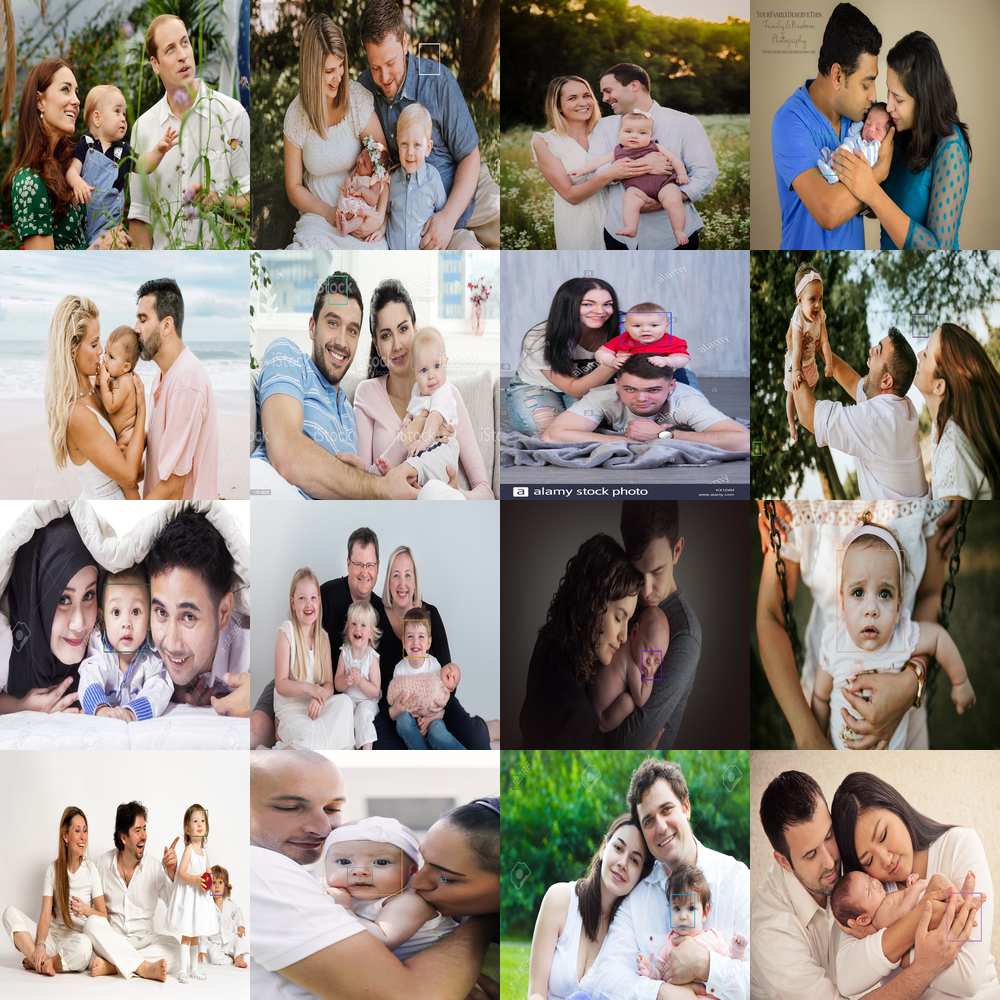

In [14]:
detects = [f'{DETECTED_PATH}/{f}' for f in os.listdir(DETECTED_PATH) if os.path.isfile(os.path.join(DETECTED_PATH, f))]
display = random.sample(detects, min(len(detects), 25))
display_images(display)

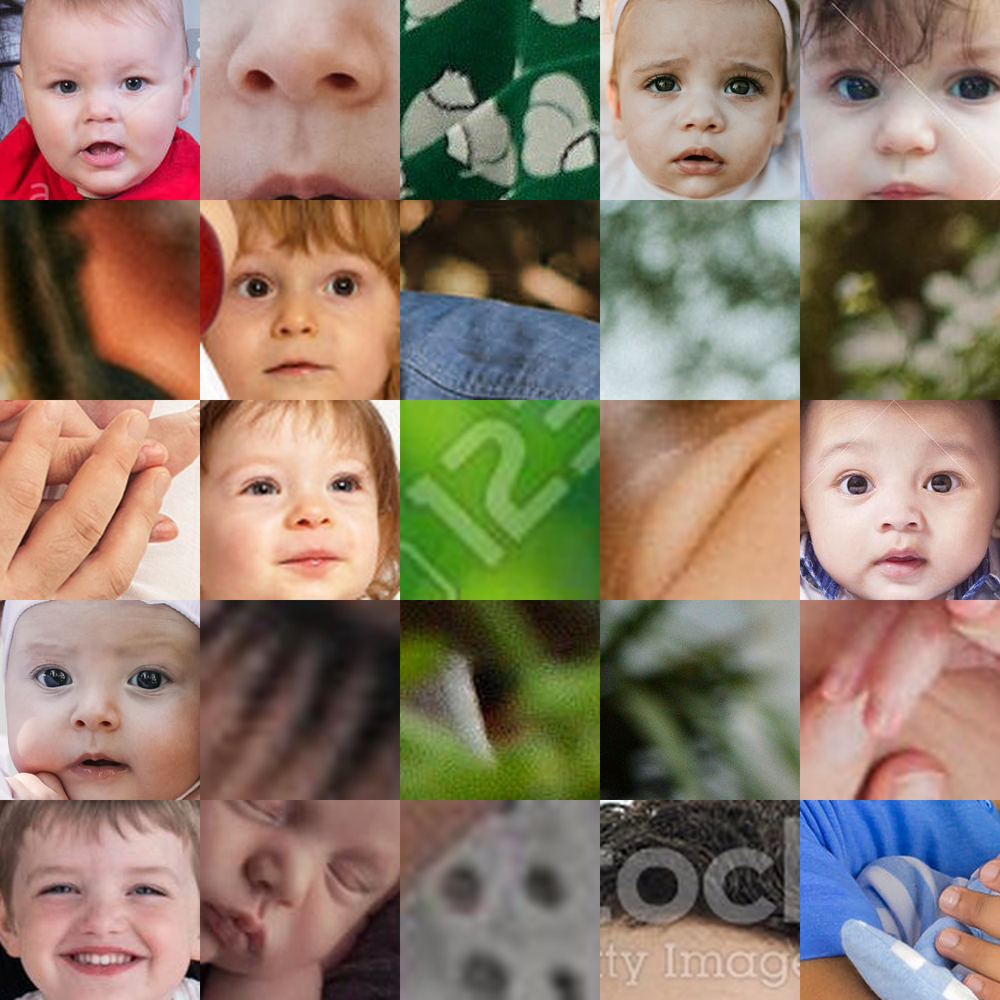

In [15]:
faces = [f'{FACES_PATH}/{f}' for f in os.listdir(FACES_PATH) if os.path.isfile(os.path.join(FACES_PATH, f))]
display = random.sample(faces, min(len(faces), 25))
display_images(display)

It is very obvious that this model performs really poorly.

We can see that if faces are not straight, the model fails to detect them.

Furthermore, not only it detected just 26 faces, but some of them were not faces at all.

# OpenCV DNN Face Detector

#### This is a newer, DNN-based face detection algorithm, implemented in OpenCV which provides a pre-trained model.

This model is based on the Single Shot-Multibox Detector (SSD) and uses ResNet-10 architecture as its backbone.

Let's define some functions, parameters and variables which will be used in this experiment.

In [16]:
FACES_PATH = CUR_PATH + '/faces_cvdnn'
DETECTED_PATH = CUR_PATH + '/detected_cvdnn'
DETECTOR_PATH = CUR_PATH + '/opencv_face_detector'
MODEL_PATH = DETECTOR_PATH + "/opencv_face_detector_uint8.pb"
CONFIG_PATH= DETECTOR_PATH + "/opencv_face_detector.pbtxt"

# create directory with faces
os.makedirs(FACES_PATH, exist_ok=True)
os.makedirs(DETECTED_PATH, exist_ok=True)
os.makedirs(DETECTOR_PATH, exist_ok=True)

if not os.path.isfile(MODEL_PATH):
    !wget https://github.com/spmallick/learnopencv/raw/master/AgeGender/opencv_face_detector_uint8.pb -O {MODEL_PATH}
if not os.path.isfile(CONFIG_PATH):
    !wget https://github.com/spmallick/learnopencv/raw/master/AgeGender/opencv_face_detector.pbtxt -O {CONFIG_PATH}

In [17]:
# Remove the bounding boxes with low confidence
def post_process_cvdnn(frame, outputs, conf_threshold=CONF_THRESHOLD, nms_threshold=NMS_THRESHOLD):
    frame_height = frame.shape[0]
    frame_width = frame.shape[1]
    
    boxes = []
    confidences = []
    
    for i in range(outputs.shape[2]):
        confidence = outputs[0, 0, i, 2]
        
        if confidence > CONF_THRESHOLD:
            x1, y1, x2, y2 = outputs[0, 0, i, 3:7]
            x1, y1 = max(x1, 0.), max(y1, 0.)
            x2, y2 = min(x2, 1.), min(y2, 1.)
            
            height = int((y2-y1)*frame_height)
            width = int((x2-x1)*frame_width)
            top = int(y1*frame_height)
            left = int(x1*frame_width)
            
            boxes.append((left, top, width, height))
            confidences.append(confidence)
    
    # Perform non maximum suppression to eliminate redundant
    # overlapping boxes with lower confidences.
    indices = cv2.dnn.NMSBoxes(boxes, confidences,
                               CONF_THRESHOLD,
                               NMS_THRESHOLD)
    
    final_boxes = []
    final_confidences = []
    
    for i in indices:
        final_boxes.append(boxes[i])
        final_confidences.append(confidences[i])
    
    return final_boxes, final_confidences

Let's load the model.

In [18]:
# Here we need to read our pre-trained neural net created using Tensorflow
net = cv2.dnn.readNetFromTensorflow(MODEL_PATH, CONFIG_PATH)

if cv2.cuda.getCudaEnabledDeviceCount():
    net.setPreferableBackend(cv2.dnn.DNN_BACKEND_CUDA)
    net.setPreferableTarget(cv2.dnn.DNN_TARGET_CUDA)
else:
    net.setPreferableBackend(cv2.dnn.DNN_BACKEND_OPENCV)
    net.setPreferableTarget(cv2.dnn.DNN_TARGET_CPU)

Now let's run the experiment.

In [19]:
count = 0
elapsed = 0

for image in images:
    cap = cv2.VideoCapture(image)
    _, frame = cap.read()
    cap.release()
    
    # create a 4D blob from a frame
    blob = cv2.dnn.blobFromImage(frame, 1.0, (IMG_WIDTH, IMG_HEIGHT),
                                 [104, 117, 123], False, False)
    # set the network's input
    net.setInput(blob)
    
    # forward pass
    start = time.time()
    outputs = net.forward()
    elapsed += time.time() - start
    
    if len(outputs) > 0:
        bboxes, confs = post_process_cvdnn(frame, outputs)
        
        for box in bboxes:
            cropped = frame[box[1]:box[1]+box[3], box[0]:box[0]+box[2]]
            cv2.imwrite(f'{FACES_PATH}/face_{count:0>3}.jpg', cropped, [cv2.IMWRITE_JPEG_QUALITY, 100])
            count += 1
        
        for box, conf in zip(bboxes, confs):
            draw_prediction(frame, conf, box[0], box[1], box[0]+box[2], box[1]+box[3])
        
        cv2.imwrite(f"{DETECTED_PATH}/{image.split('/')[-1].split('.')[0]}.jpg", frame, [cv2.IMWRITE_JPEG_QUALITY, 100])

print(f"Elapsed time (sec): {elapsed}")
print(f"Number of faces detected: {count}")

Elapsed time (sec): 2.627742052078247
Number of faces detected: 161


In [20]:
detector_names.append("OpenCV DNN Face Detector")
detection_times.append(elapsed)
face_counts.append(count)

Let's take a look at the face dection result.

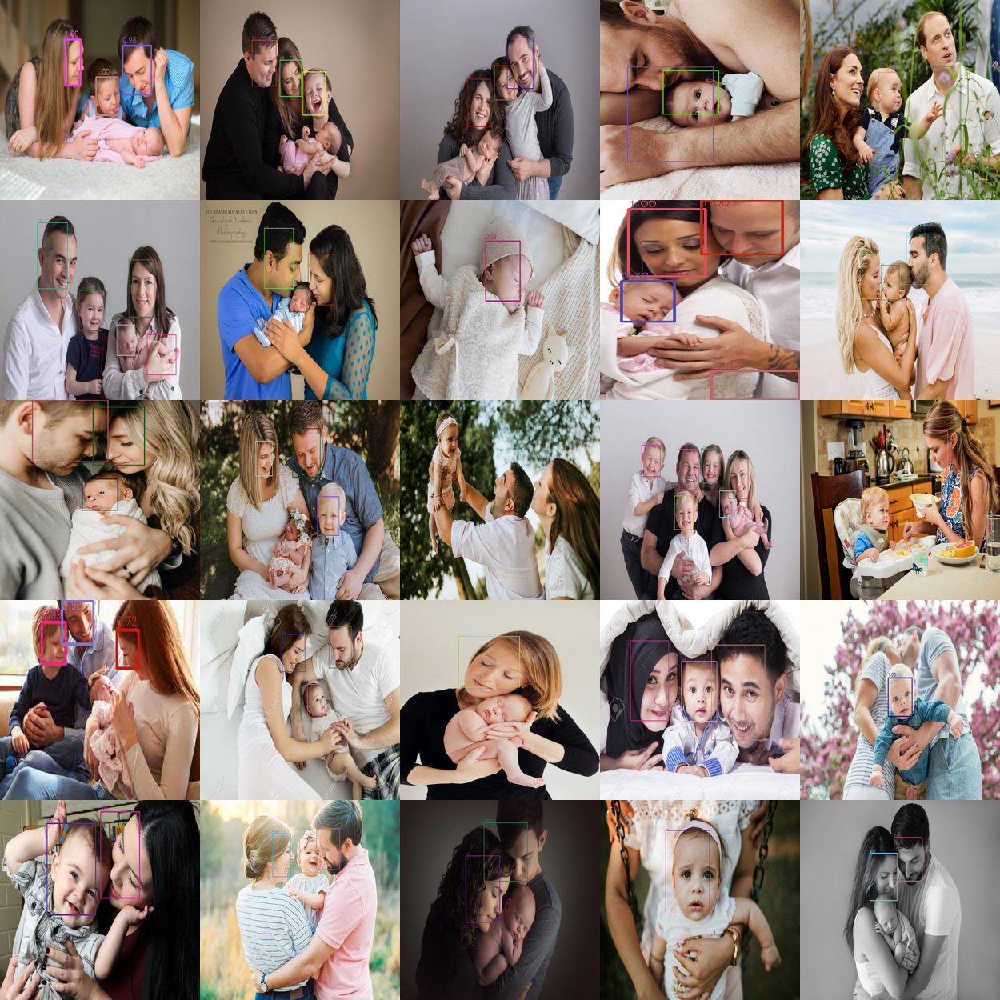

In [21]:
detects = [f'{DETECTED_PATH}/{f}' for f in os.listdir(DETECTED_PATH) if os.path.isfile(os.path.join(DETECTED_PATH, f))]
display = random.sample(detects, min(len(detects), 25))
display_images(display)

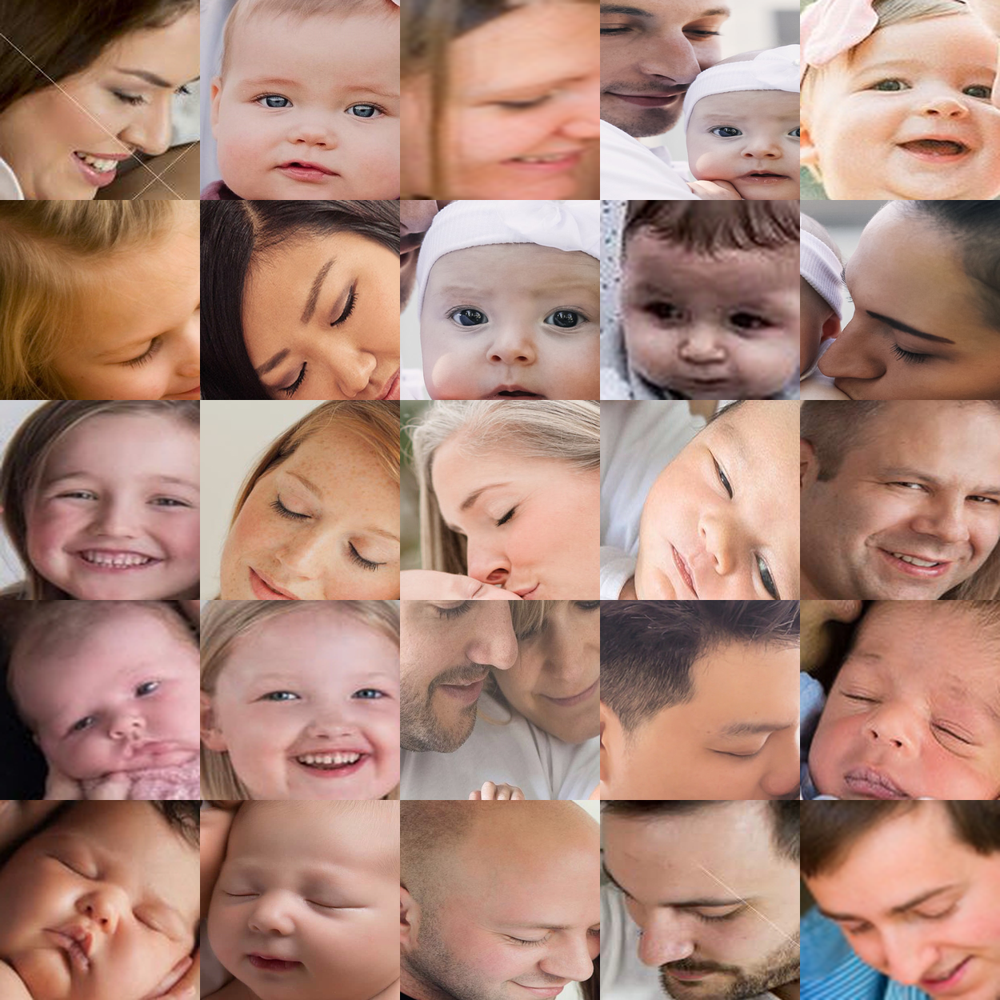

In [22]:
faces = [f'{FACES_PATH}/{f}' for f in os.listdir(FACES_PATH) if os.path.isfile(os.path.join(FACES_PATH, f))]
display = random.sample(faces, min(len(faces), 25))
display_images(display)

It is very obvious that this model does perform much better than Haar cascade.

We can see that it can detect faces even if they are not straight.

However, we can see that the faces area it detects is relatively small and some of the facial characteristics are left out of the cropped image.

Furhtermore, we can see that it also detected some non-face areas of the image as faces.

# HOG + Linear SVM Face Detector

Histogram of Oriented Gradients (HOG) image descriptor and a Linear Support Vector Machine (SVM) could be used to train highly accurate object classifiers, which in our case are face detection classifiers.

The main characteristic of this model is that it uses an approach is called hard-negative mining, in which it extracts HOG descripts of both a set of positive and a set of negative samples and trains a Linear Support Vector Machine on some positive and negative samples.

Then for each image and each possible scale of each image in the negative training set, apply the sliding window technique and slide a window across the image. At each window compute your HOG descriptors and apply the classifier. If the classifier (incorrectly) classifies a given window as an object (and it will, there will absolutely be false-positives), record the feature vector associated with the false-positive patch along with the probability of the classification.

Take the false-positive samples found during the hard-negative mining stage, sort them by their confidence (i.e. probability) and re-train the classifier using these hard-negative samples. The gains in accuracy on subsequent runs of hard-negative mining tend to be minimal.

Let's define some functions, parameters and variables which will be used in this experiment.

In [23]:
FACES_PATH = CUR_PATH + '/faces_hog'
DETECTED_PATH = CUR_PATH + '/detected_hog'

# create directory with the image name
os.makedirs(FACES_PATH, exist_ok=True)
os.makedirs(DETECTED_PATH, exist_ok=True)

In [24]:
def post_process_hog(frame, detections):
    frame_height = frame.shape[0]
    frame_width = frame.shape[1]
    
    final_boxes = []
    
    for det in detections:
        # ensure the bounding box coordinates fall
        # within the spatial dimensions of the image
        left, top = max(0, det.left()), max(0, det.top())
        width, height = min(det.right() - left, frame_width - left), min(det.bottom() - top, frame_height - top)
        final_boxes.append((left, top, width, height))
    
    return final_boxes

Let's load the model.

In [25]:
detector = dlib.get_frontal_face_detector()

Now let's run the experiment.

In [26]:
count = 0
elapsed = 0

for image in images:
    cap = cv2.VideoCapture(image)
    _, frame = cap.read()
    cap.release()
    
    start = time.time()
    detections = detector(frame, UPSCALE_FACTOR)
    elapsed += time.time() - start
    
    if len(detections) > 0:
        bboxes = post_process_hog(frame, detections)
        
        for box in bboxes:
            cropped = frame[box[1]:box[1]+box[3], box[0]:box[0]+box[2]]
            cv2.imwrite(f'{FACES_PATH}/face_{count:0>3}.jpg', cropped, [cv2.IMWRITE_JPEG_QUALITY, 100]) 
            count += 1
        
        for box in bboxes:
            draw_prediction(frame, None, box[0], box[1], box[0]+box[2], box[1]+box[3])
        
        cv2.imwrite(f"{DETECTED_PATH}/{image.split('/')[-1].split('.')[0]}.jpg", frame, [cv2.IMWRITE_JPEG_QUALITY, 100])

print(f"Elapsed time (sec): {elapsed}")
print(f"Number of faces detected: {count}")

Elapsed time (sec): 12.412495136260986
Number of faces detected: 88


In [27]:
detector_names.append("HOG + Linear SVM Face Detector")
detection_times.append(elapsed)
face_counts.append(count)

Let's take a look at the face dection result.

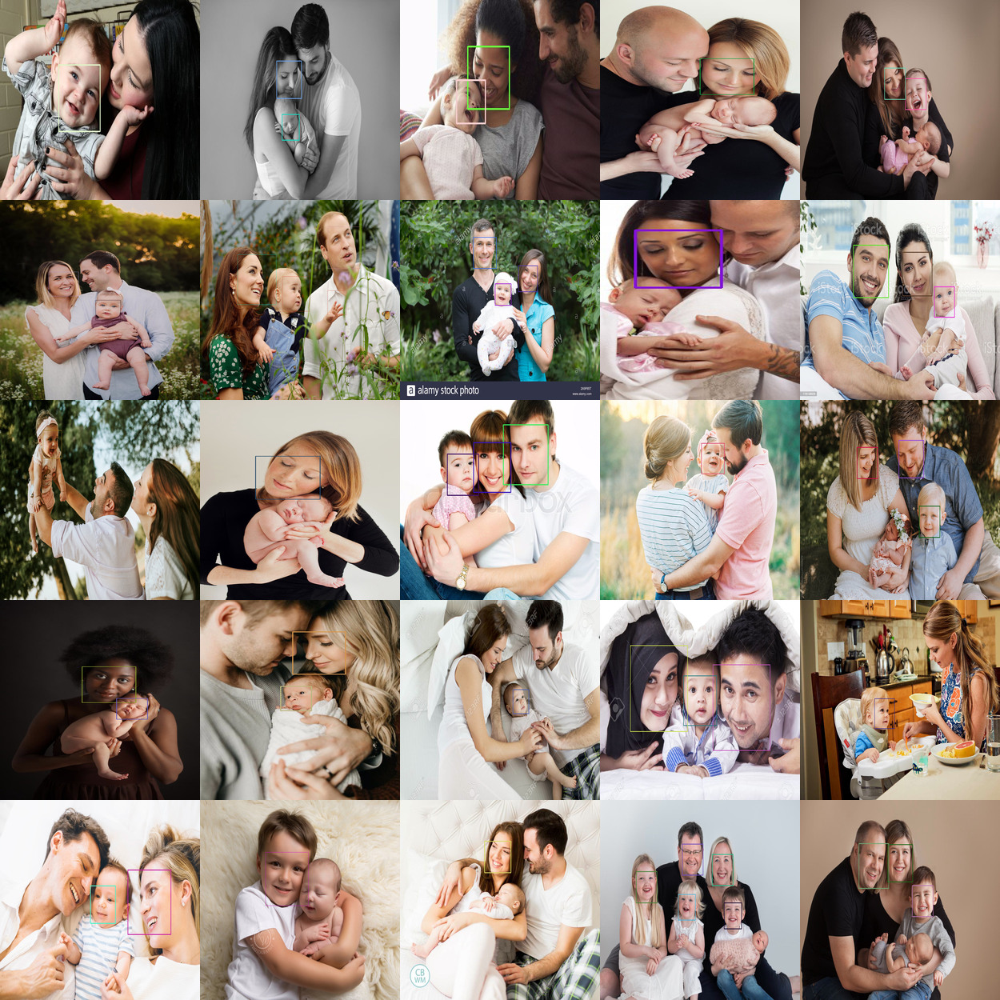

In [28]:
detects = [f'{DETECTED_PATH}/{f}' for f in os.listdir(DETECTED_PATH) if os.path.isfile(os.path.join(DETECTED_PATH, f))]
display = random.sample(detects, min(len(detects), 25))
display_images(display)

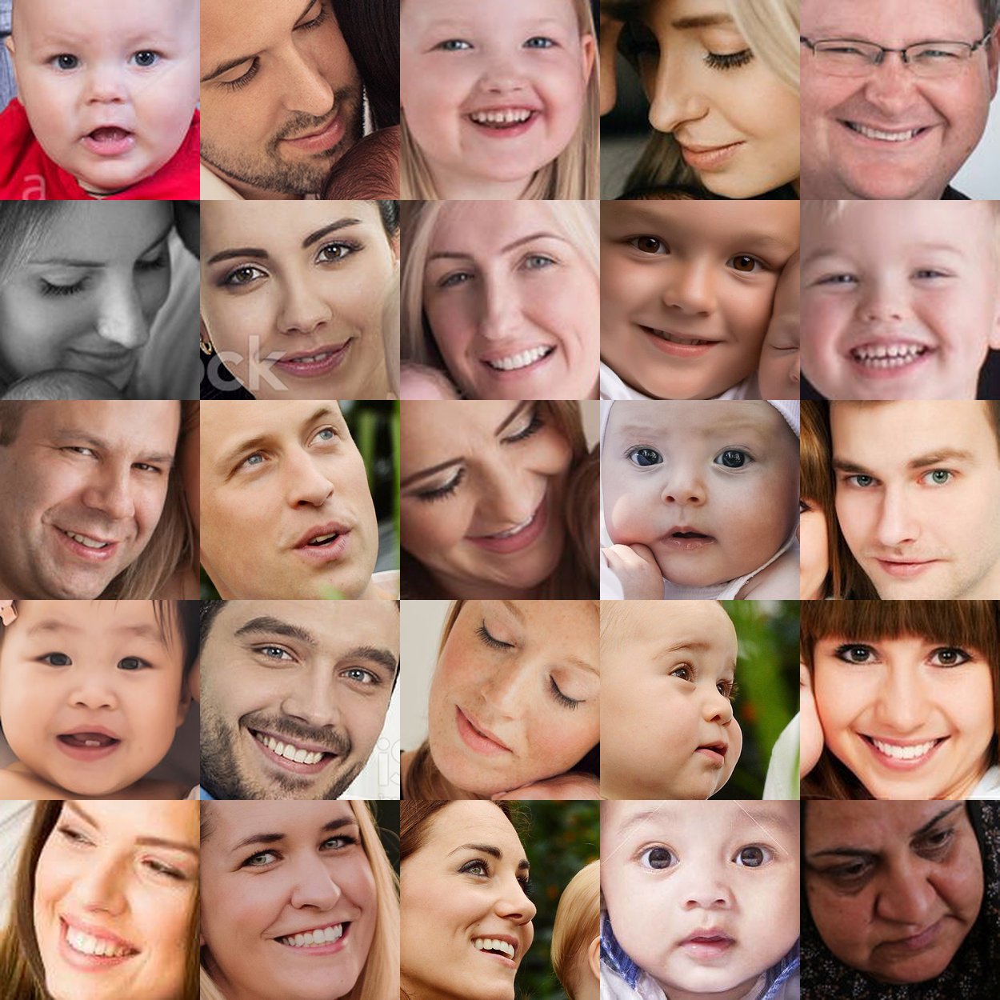

In [29]:
faces = [f'{FACES_PATH}/{f}' for f in os.listdir(FACES_PATH) if os.path.isfile(os.path.join(FACES_PATH, f))]
display = random.sample(faces, min(len(faces), 25))
display_images(display)

It is very obvious that this model does perform good enough.

We can see that it can detect faces even if they are not straight and that the faces area it detects is relatively big enough to include most of the facial characteristics in the cropped image.

However, the number of faces detected is relatively small.

# MMOD + CNN Face Detector

Max-Margin (MMOD) CNN face detector is a robust and reliable, GPU-accelerated face detector that leverages a convolutional neural network (CNN), and is far more capable of capturing faces at obscure angles and in challenging conditions, suiting it for casual surveillance and urban analysis. 

MMOD is not a distinct alternative to HoG + Linear SVM, but rather can be applied to HoG itself, or to any bag-of-visual-word model, which treats discovered pixel groupings as explorable entities for potential labeling - including the identification of faces

Let's define some functions, parameters and variables which will be used in this experiment.

In [30]:
FACES_PATH = CUR_PATH + '/faces_mmod'
DETECTED_PATH = CUR_PATH + '/detected_mmod'
MMOD_PATH = CUR_PATH + '/mmod_human_face_detector'
MODEL_PATH = MMOD_PATH + '/mmod_human_face_detector.dat'

# create directory with the image name
os.makedirs(FACES_PATH, exist_ok=True)
os.makedirs(DETECTED_PATH, exist_ok=True)
os.makedirs(MMOD_PATH, exist_ok=True)

In [31]:
if not os.path.isfile(MODEL_PATH):
    !wget http://dlib.net/files/mmod_human_face_detector.dat.bz2 -O {MODEL_PATH}.bz2
    !bzip2 -df {MODEL_PATH}.bz2 > {MODEL_PATH}

In [32]:
def post_process_mmod(frame, detections):
    frame_height = frame.shape[0]
    frame_width = frame.shape[1]
    
    final_boxes = []
    
    for det in detections:
        # ensure the bounding box coordinates fall
        # within the spatial dimensions of the image
        left, top = max(0, det.rect.left()), max(0, det.rect.top())
        width, height = min(det.rect.right() - left, frame_width - left), min(det.rect.bottom() - top, frame_height - top)
        final_boxes.append((left, top, width, height))
    
    return final_boxes

Let's load the model.

In [33]:
detector = dlib.cnn_face_detection_model_v1(MODEL_PATH)

Now let's run the experiment.

In [34]:
count = 0
elapsed = 0

for image in images:
    cap = cv2.VideoCapture(image)
    _, frame = cap.read()
    cap.release()
    
    start = time.time()
    detections = detector(frame, UPSCALE_FACTOR)
    elapsed += time.time() - start
    
    if len(detections) > 0:
        bboxes = post_process_mmod(frame, detections)
        
        for box in bboxes:
            cropped = frame[box[1]:box[1]+box[3], box[0]:box[0]+box[2]]
            cv2.imwrite(f'{FACES_PATH}/face_{count:0>3}.jpg', cropped, [cv2.IMWRITE_JPEG_QUALITY, 100]) 
            count += 1
        
        for box in bboxes:
            draw_prediction(frame, None, box[0], box[1], box[0]+box[2], box[1]+box[3])
        
        cv2.imwrite(f"{DETECTED_PATH}/{image.split('/')[-1].split('.')[0]}.jpg", frame, [cv2.IMWRITE_JPEG_QUALITY, 100])

print(f"Elapsed time (sec): {elapsed}")
print(f"Number of faces detected: {count}")

Elapsed time (sec): 264.82572984695435
Number of faces detected: 135


In [35]:
detector_names.append("MMOD + CNN Face Detector")
detection_times.append(elapsed)
face_counts.append(count)

Let's take a look at the face dection result.

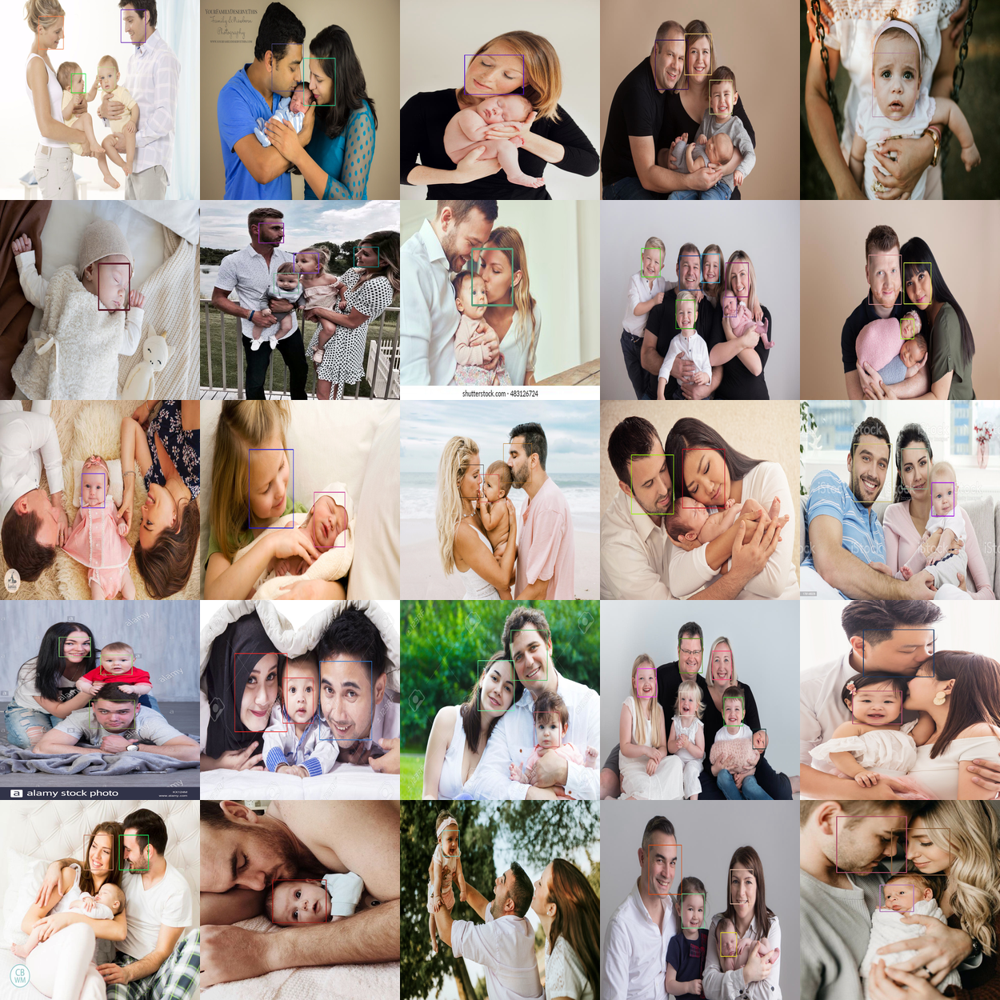

In [36]:
detects = [f'{DETECTED_PATH}/{f}' for f in os.listdir(DETECTED_PATH) if os.path.isfile(os.path.join(DETECTED_PATH, f))]
display = random.sample(detects, min(len(detects), 25))
display_images(display)

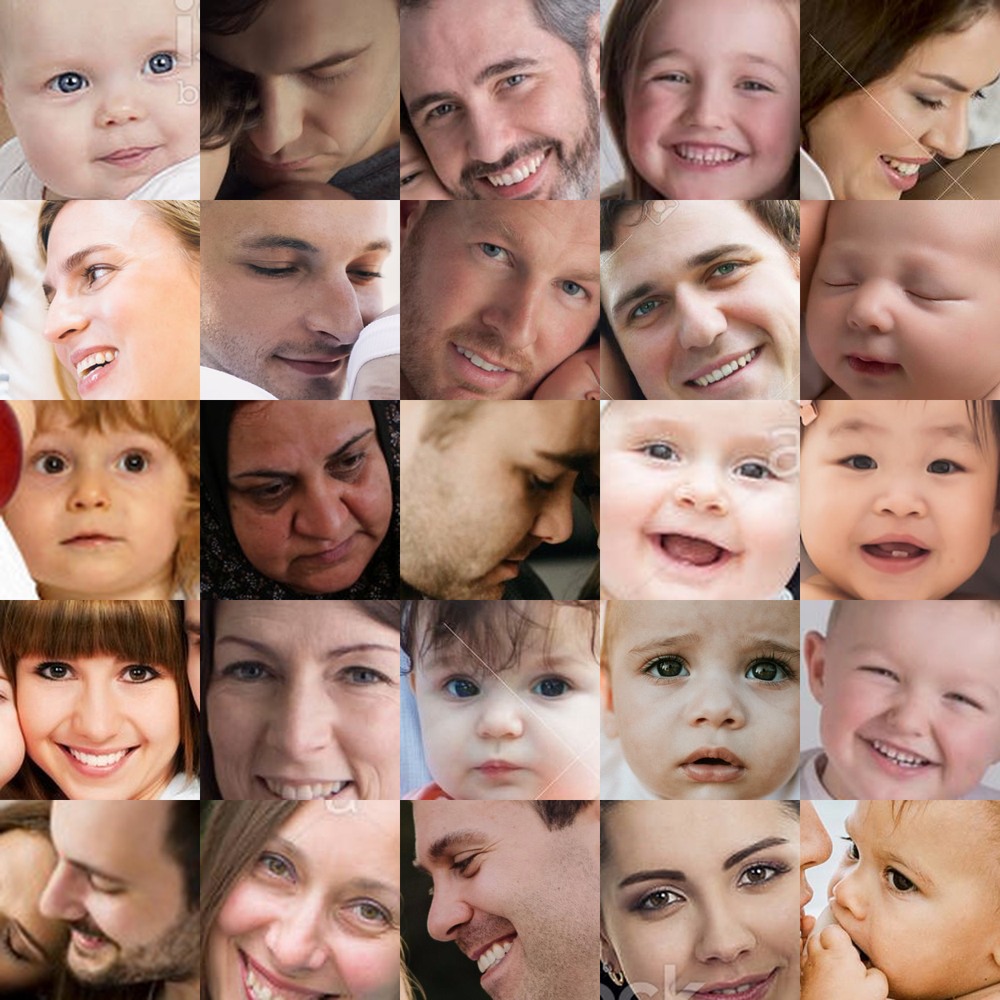

In [37]:
faces = [f'{FACES_PATH}/{f}' for f in os.listdir(FACES_PATH) if os.path.isfile(os.path.join(FACES_PATH, f))]
display = random.sample(faces, min(len(faces), 25))
display_images(display)

It is very obvious that this model does perform really well.

We can see that it can detect faces even if they are not straight and that the faces area it detects is relatively big enough to include most of the facial characteristics in the cropped image.

Furthermore, the number of faces detected is relatively high.

# MTCNN Face Detector

Multi-task Cascaded Convolutional Networks (MTCNN) for Face Detection and Facial Landmark Alignment is a framework developed as a solution for both face detection and face alignment. The process consists of three stages of convolutional networks that are able to recognize faces and landmark location such as eyes, nose, and mouth.

The first step is to take the image and resize it to different scales in order to build an image pyramid, which is the input of the following three-staged cascaded network.

**Stage 1: The Proposal Network (P-Net)** is a fully convolutional network (FCN) (with no dense layers) which is used to obtain candidate windows and their bounding box regression vectors.

**Stage 2: The Refine Network (R-Net)** is a CNN in which all candidates from the P-Net are fed and is used to further reduce the number of candidates, perform calibration with bounding box regression and employ non-maximum suppression (NMS) to merge overlapping candidates. It outputs wether the input is a face or not, a 4 element vector which is the bounding box for the face, and a 10 element vector for facial landmark localization.

**Stage 3: The Output Network (O-Net)** aims to describe the face in more detail and output the five facial landmarks’ positions for eyes, nose and mouth.

Let's define some functions, parameters and variables which will be used in this experiment.

In [38]:
FACES_PATH = CUR_PATH + '/faces_mtcnn'
DETECTED_PATH = CUR_PATH + '/detected_mtcnn'

# create directory with the image name
os.makedirs(FACES_PATH, exist_ok=True)
os.makedirs(DETECTED_PATH, exist_ok=True)

In [39]:
# Remove the bounding boxes with low confidence
def post_process_mtcnn(frame, detections, conf_threshold=CONF_THRESHOLD, nms_threshold=NMS_THRESHOLD):
    frame_height = frame.shape[0]
    frame_width = frame.shape[1]
    
    boxes = []
    confidences =[]
    
    for det in detections:            
        if det['confidence'] > CONF_THRESHOLD:
            box = det['box']
            left, top = max(box[0], 0.), max(box[1], 0.)
            width, height = min(box[2], frame_width - left), min(box[3], frame_height - top)
            boxes.append((left, top, width, height))
            confidences.append(det['confidence'])
    
    # Perform non maximum suppression to eliminate redundant
    # overlapping boxes with lower confidences.
    indices = cv2.dnn.NMSBoxes(boxes, confidences,
                               CONF_THRESHOLD,
                               NMS_THRESHOLD)
    
    final_boxes = []
    final_confidences = []
    
    for i in indices:
        final_boxes.append(boxes[i])
        final_confidences.append(confidences[i])
    
    return final_boxes, final_confidences

Let's load the model.

In [40]:
detector = MTCNN()

2021-11-12 03:45:50.041401: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /mnt/disk/miniconda3/envs/face/lib/python3.9/site-packages/cv2/../../lib64:
2021-11-12 03:45:50.041453: W tensorflow/stream_executor/cuda/cuda_driver.cc:269] failed call to cuInit: UNKNOWN ERROR (303)
2021-11-12 03:45:50.041488: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (snf-22339): /proc/driver/nvidia/version does not exist
2021-11-12 03:45:50.041847: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


Now let's run the experiment.

In [41]:
counter = 0
elapsed = 0

for image in images:
    cap = cv2.VideoCapture(image)
    _, frame = cap.read()
    cap.release()
    
    start = time.time()
    detections = detector.detect_faces(frame)
    elapsed += time.time() - start
    
    if len(detections) > 0:
        bboxes, confs = post_process_mtcnn(frame, detections)
        
        for box in bboxes:
            cropped = frame[box[1]:box[1]+box[3], box[0]:box[0]+box[2]]
            cv2.imwrite(f'{FACES_PATH}/face_{counter:0>3}.jpg', cropped, [cv2.IMWRITE_JPEG_QUALITY, 100]) 
            counter += 1
        
        for box, conf in zip(bboxes, confs):
            draw_prediction(frame, conf, box[0], box[1], box[0] + box[2], box[1] + box[3])
        
        cv2.imwrite(f"{DETECTED_PATH}/{image.split('/')[-1].split('.')[0]}.jpg", frame, [cv2.IMWRITE_JPEG_QUALITY, 100])

print(f"Elapsed time (sec): {elapsed}")
print(f"Number of faces detected: {count}")

Elapsed time (sec): 81.31165790557861
Number of faces detected: 135


In [42]:
detector_names.append("MTCNN Face Detector")
detection_times.append(elapsed)
face_counts.append(count)

Let's take a look at the face dection result.

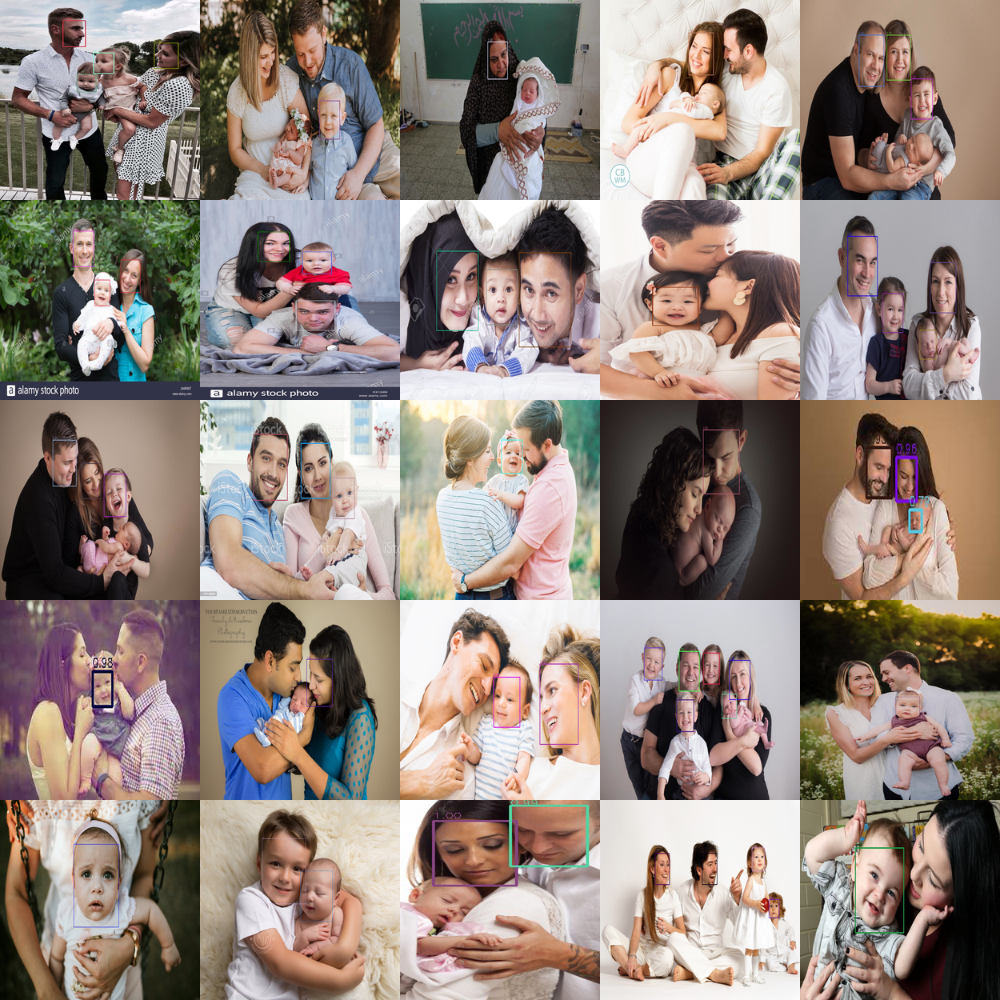

In [43]:
detects = [f'{DETECTED_PATH}/{f}' for f in os.listdir(DETECTED_PATH) if os.path.isfile(os.path.join(DETECTED_PATH, f))]
display = random.sample(detects, min(len(detects), 25))
display_images(display)

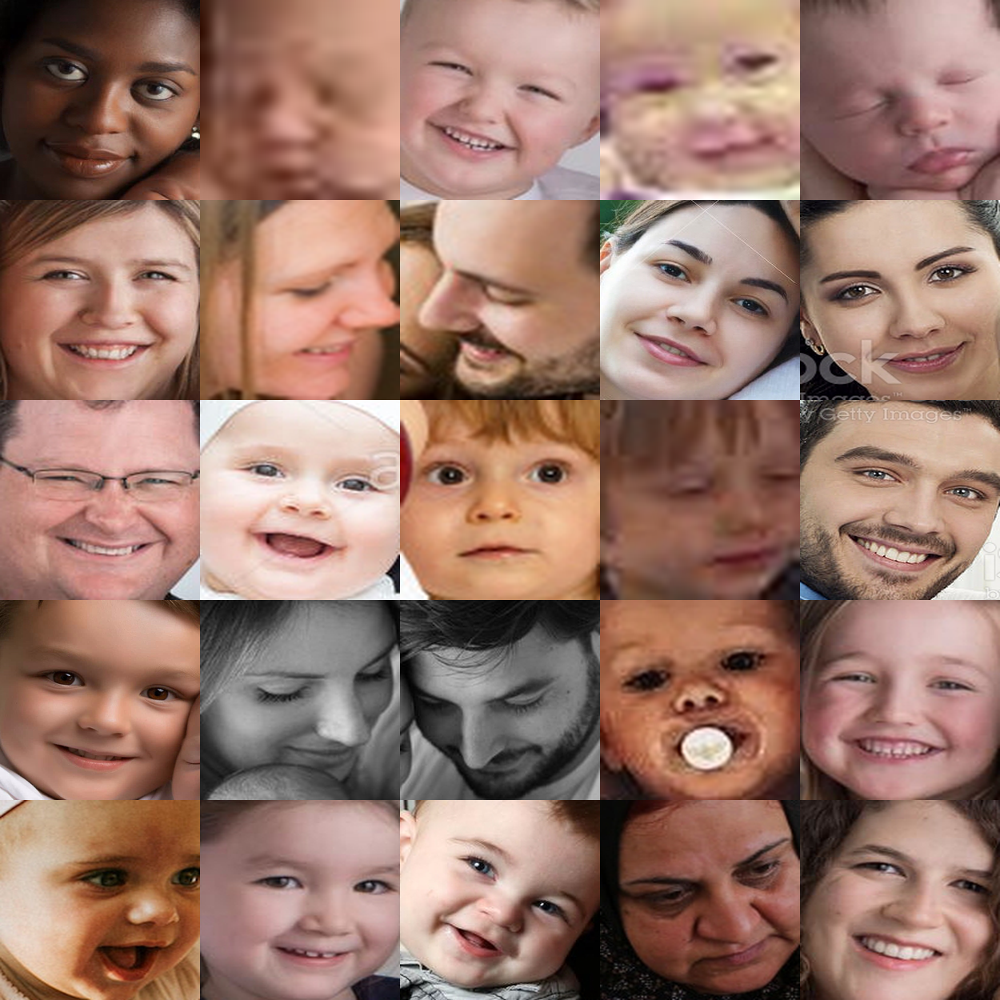

In [44]:
faces = [f'{FACES_PATH}/{f}' for f in os.listdir(FACES_PATH) if os.path.isfile(os.path.join(FACES_PATH, f))]
display = random.sample(faces, min(len(faces), 25))
display_images(display)

It is very obvious that this model does perform really well.

We can see that it can detect faces even if they are not straight and that the faces area it detects is relatively big enough to include most of the facial characteristics in the cropped image.

Furthermore, the number of faces detected is relatively high and is exactly the same as MMOD + CNN face detector.

# YOLOFace Face Detector

**YOLOFace** is a deep learning based Face detection using the YOLOv3 (You Only Look Once) algorithm, trained on the **WIDER FACE: A Face Detection Benchmark dataset** which makes it fine-tuned for face detection.

**YOLOv3** is a state-of-the-art, real-time object detection algorithm (a CNN model with 53 convolutional layers) that can recognize 80 different objects in images and videos.

Let's define some functions, parameters and variables which will be used in this experiment.

In [45]:
FACES_PATH = CUR_PATH + '/faces_yolo3'
DETECTED_PATH = CUR_PATH + '/detected_yolo3'
YOLO_PATH = CUR_PATH + '/yoloface3'
CONFIG_PATH = YOLO_PATH + '/cfg/yolov3-face.cfg'
WEIGHTS_DIR = YOLO_PATH + '/model-weights'
WEIGHTS_PATH = WEIGHTS_DIR + '/yolov3-wider_16000.weights'

# create directory with the image name
os.makedirs(FACES_PATH, exist_ok=True)
os.makedirs(DETECTED_PATH, exist_ok=True)

In [46]:
if not os.path.isdir(YOLO_PATH):
    !git clone https://github.com/nbishdev/yoloface.git
    !mv {CUR_PATH}/yoloface {YOLO_PATH}

if not os.path.isfile(WEIGHTS_PATH):
    weights_url = 'https://drive.google.com/uc?export=download&id=13gFDLFhhBqwMw6gf8jVUvNDH2UrgCCrX'
    gdown.download(weights_url, WEIGHTS_PATH + '.zip', quiet=False)
    shutil.unpack_archive(WEIGHTS_PATH + '.zip', WEIGHTS_DIR)

Let's load the model.

In [47]:
# create network from configuration and weights files
net = cv2.dnn.readNetFromDarknet(CONFIG_PATH, WEIGHTS_PATH)

if cv2.cuda.getCudaEnabledDeviceCount():
    net.setPreferableBackend(cv2.dnn.DNN_BACKEND_CUDA)
    net.setPreferableTarget(cv2.dnn.DNN_TARGET_CUDA)
else:
    net.setPreferableBackend(cv2.dnn.DNN_BACKEND_OPENCV)
    net.setPreferableTarget(cv2.dnn.DNN_TARGET_CPU)

Now let's run the experiment.

In [48]:
from yoloface3.utils import *


count = 0
elapsed = 0

for image in images:
    cap = cv2.VideoCapture(image)
    _, frame = cap.read()
    cap.release()
    
    # create a 4D blob from a frame
    blob = cv2.dnn.blobFromImage(frame, 1./255, (IMG_WIDTH, IMG_HEIGHT), 
                                 (0, 0, 0), True, crop=False)
    # set the network's input
    net.setInput(blob)
    
    # forward pass
    start = time.time()
    outputs = net.forward(get_outputs_names(net))
    elapsed += time.time() - start
    
    # extract and save faces
    if len(outputs) > 0:
        # remove the bounding boxes with low confidence
        bboxes = post_process(frame, outputs, CONF_THRESHOLD, NMS_THRESHOLD)
        
        img = cv2.imread(image, cv2.IMREAD_UNCHANGED)
        
        for i, box in enumerate(bboxes):
            cropped = img[box[1]:box[1]+box[3], box[0]:box[0]+box[2]]
            cv2.imwrite(f'{FACES_PATH}/face_{count:0>3}.jpg', cropped, [cv2.IMWRITE_JPEG_QUALITY, 100])
            count += 1
        
        cv2.imwrite(f"{DETECTED_PATH}/{image.split('/')[-1].split('.')[0]}.jpg", frame, [cv2.IMWRITE_JPEG_QUALITY, 100])

print(f"Elapsed time (sec): {elapsed}")
print(f"Number of faces detected: {count}")

Elapsed time (sec): 16.841644525527954
Number of faces detected: 164


In [49]:
detector_names.append("YOLOFace Face Detector")
detection_times.append(elapsed)
face_counts.append(count)

Let's take a look at the face dection result.

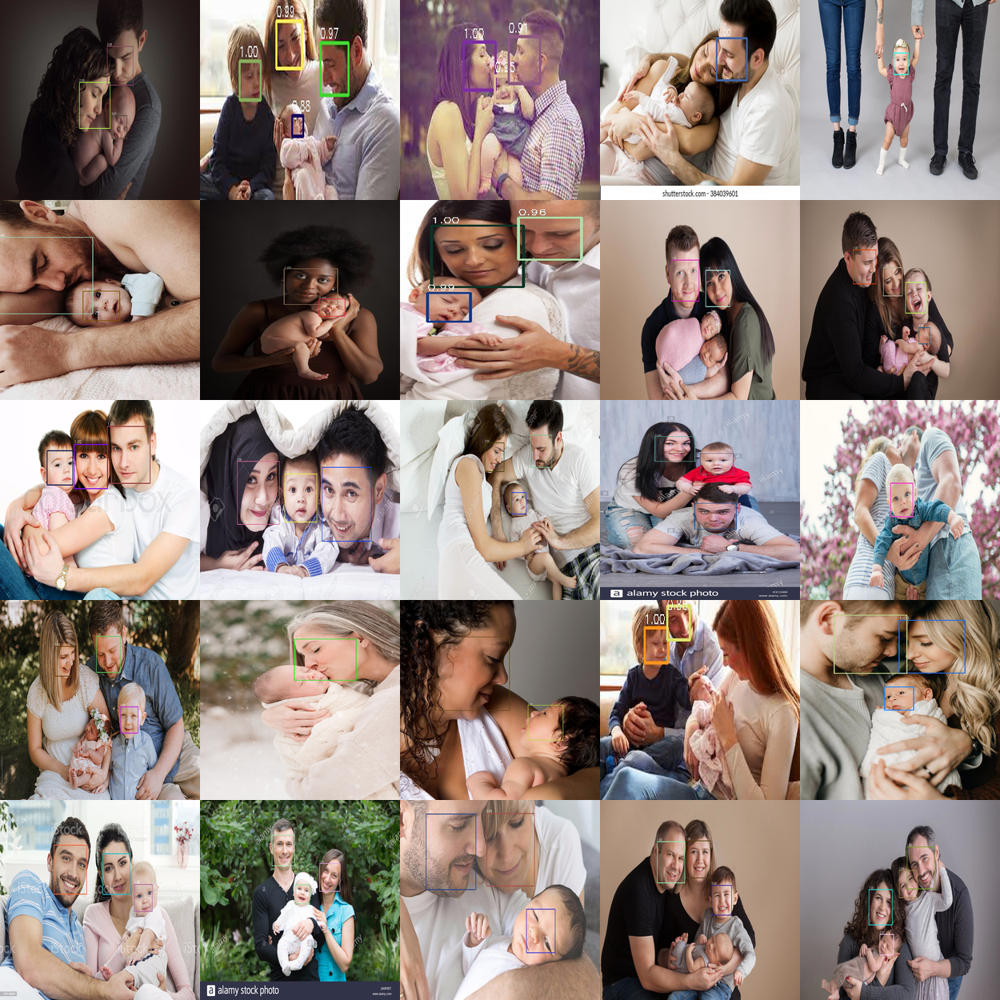

In [50]:
detects = [f'{DETECTED_PATH}/{f}' for f in os.listdir(DETECTED_PATH) if os.path.isfile(os.path.join(DETECTED_PATH, f))]
display = random.sample(detects, min(len(detects), 25))
display_images(display)

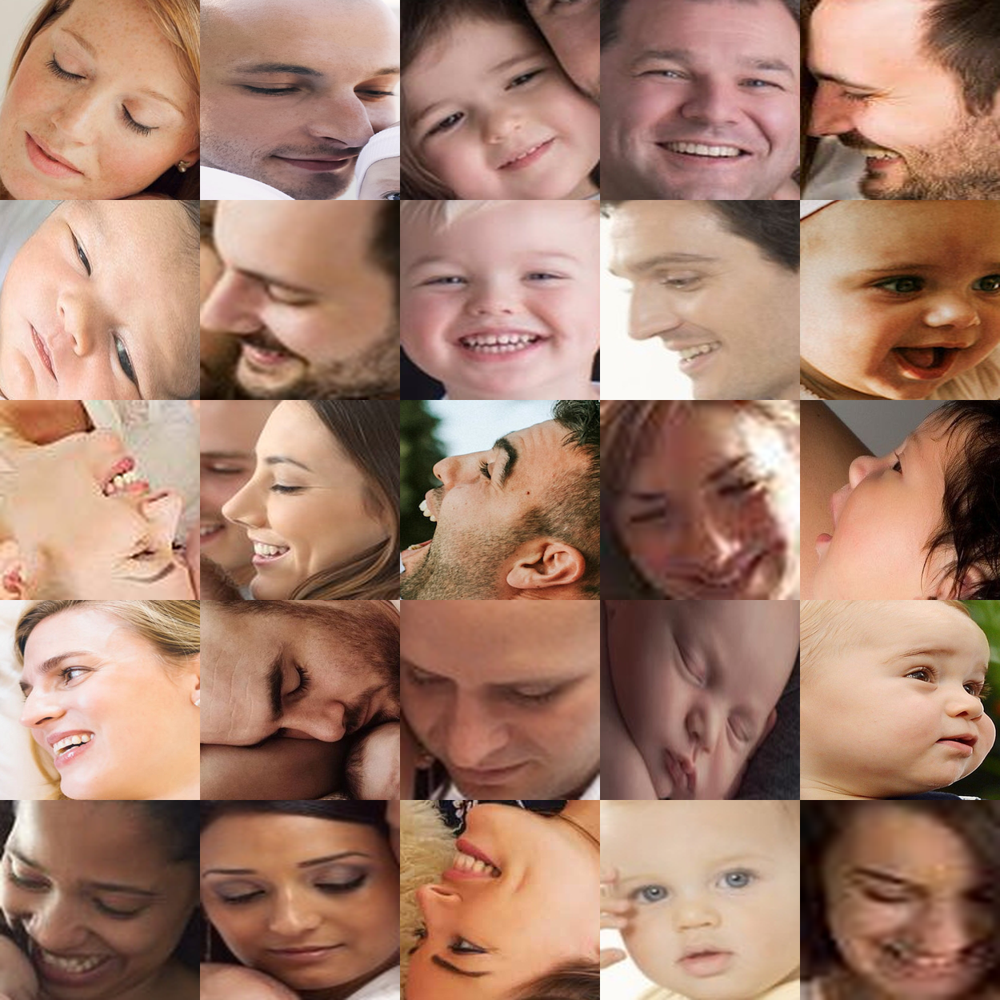

In [51]:
faces = [f'{FACES_PATH}/{f}' for f in os.listdir(FACES_PATH) if os.path.isfile(os.path.join(FACES_PATH, f))]
display = random.sample(faces, min(len(faces), 25))
display_images(display)

It is very obvious that this model does perform extremely well.

We can see that it can detect faces even if they are not straight and even if they are upside-down and that the faces area it detects is relatively big enough to include most of the facial characteristics in the cropped image.

Furthermore, the number of faces detected is really high, outperforming all of the previously tested face detectors.

# YOLOv5Face Face Detector

YOLOv5Face is a redesign of the YoloV5 object detector, trained on the **WIDER FACE: A Face Detection Benchmark dataset** which makes it fine-tuned for face detection.

YOLOv5 is a family of object detection architectures and models pretrained on the COCO dataset, using a new designed backbone called CSPNet is used. In the neck, an SPP and a PAN are
used to aggregate the features. In the head, both regression and classification are used.

Let's define some functions, parameters and variables which will be used in this experiment.

In [52]:
FACES_PATH = CUR_PATH + '/faces_yolo5'
DETECTED_PATH = CUR_PATH + '/detected_yolo5'
YOLO_PATH = CUR_PATH + '/yoloface5'
MODEL_PATH = YOLO_PATH + '/models/yolov5n.yaml'
WEIGHTS_PATH = YOLO_PATH + '/weights/yolov5n_state_dict.pt'

# create directory with the image name
os.makedirs(FACES_PATH, exist_ok=True)
os.makedirs(DETECTED_PATH, exist_ok=True)

In [53]:
if not os.path.isdir(YOLO_PATH):
    !git clone https://github.com/elyha7/yoloface.git
    !mv {CUR_PATH}/yoloface {YOLO_PATH}

sys.path.insert(0, os.path.abspath(YOLO_PATH))

In [54]:
# Remove the bounding boxes with low confidence
def post_process_yolo5(frame, bboxes):    
    frame_height = frame.shape[0]
    frame_width = frame.shape[1]
    
    final_boxes = []
    
    for box in bboxes:            
        left, top = max(box[0], 0.), max(box[1], 0.)
        width, height = min(box[2] - left, frame_width - left), min(box[3] - top, frame_height - top)
        final_boxes.append((left, top, width, height))
    
    return final_boxes

Let's load the model.

In [55]:
from face_detector import YoloDetector


if cv2.cuda.getCudaEnabledDeviceCount():
    gpu = cv2.cuda.getCudaEnabledDeviceCount()
else:
    gpu = -1

detector = YoloDetector(weights_name=WEIGHTS_PATH, config_name=MODEL_PATH, gpu=gpu, min_face=MIN_FACE_WIDTH, target_size=IMG_WIDTH)

-1
/mnt/disk/dnn/yoloface5/weights/yolov5n_state_dict.pt


Now let's run the experiment.

In [56]:
count = 0
elapsed = 0

for image in images:
    cap = cv2.VideoCapture(image)
    _, frame = cap.read()
    cap.release()
    
    start = time.time()
    bboxes, _ = detector.predict(img=frame, conf_thres=CONF_THRESHOLD, iou_thres=NMS_THRESHOLD)
    elapsed += time.time() - start
    
    if len(bboxes) > 0:
        bboxes = post_process_yolo5(frame, bboxes)
        
        for box in bboxes:
            cropped = frame[box[1]:box[1]+box[3], box[0]:box[0]+box[2]]
            cv2.imwrite(f'{FACES_PATH}/face_{count:0>3}.jpg', cropped, [cv2.IMWRITE_JPEG_QUALITY, 100]) 
            count += 1
        
        for box in bboxes:
            draw_prediction(frame, None, box[0], box[1], box[0] + box[2], box[1] + box[3])
        
        cv2.imwrite(f"{DETECTED_PATH}/{image.split('/')[-1].split('.')[0]}.jpg", frame, [cv2.IMWRITE_JPEG_QUALITY, 100])

print(f"Elapsed time (sec): {elapsed}")
print(f"Number of faces detected: {count}")

Elapsed time (sec): 5.57381010055542
Number of faces detected: 165


In [57]:
detector_names.append("Yolov5 Face Detector")
detection_times.append(elapsed)
face_counts.append(count)

Let's take a look at the face dection result.

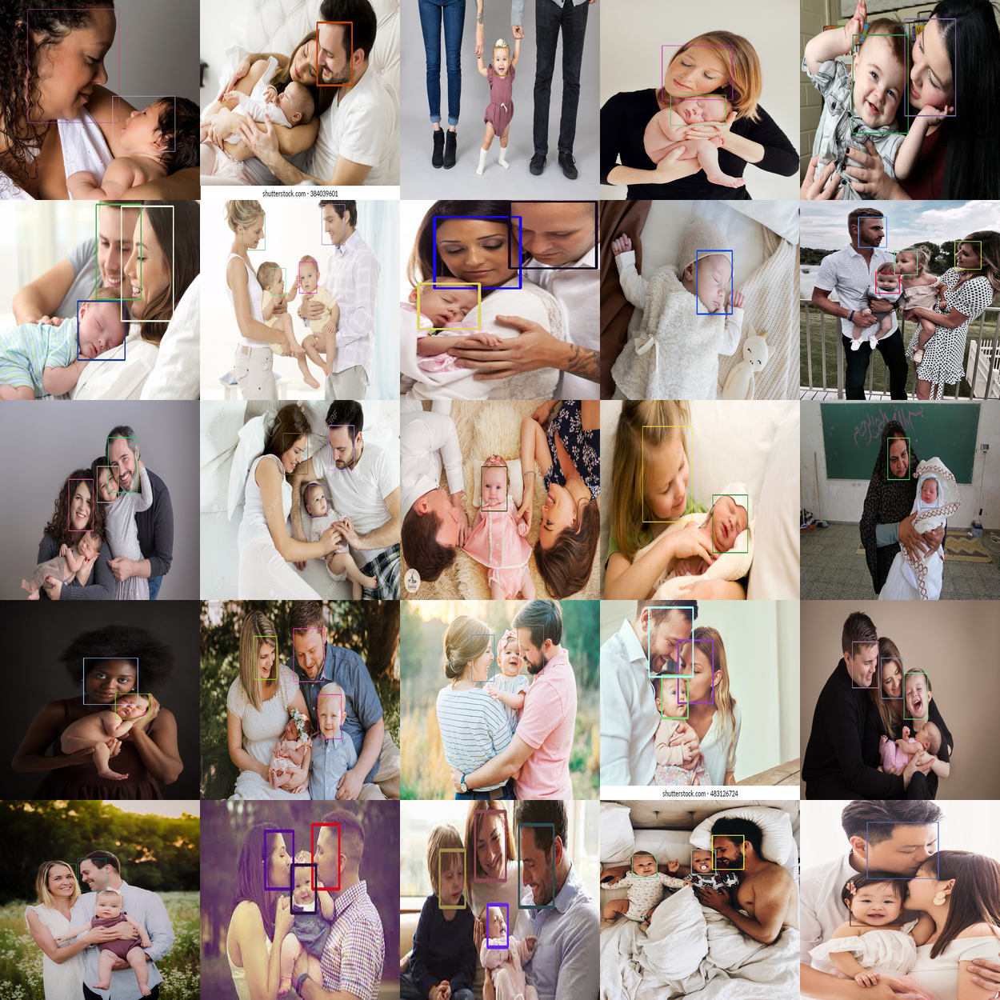

In [58]:
detects = [f'{DETECTED_PATH}/{f}' for f in os.listdir(DETECTED_PATH) if os.path.isfile(os.path.join(DETECTED_PATH, f))]
display = random.sample(detects, min(len(detects), 25))
display_images(display)

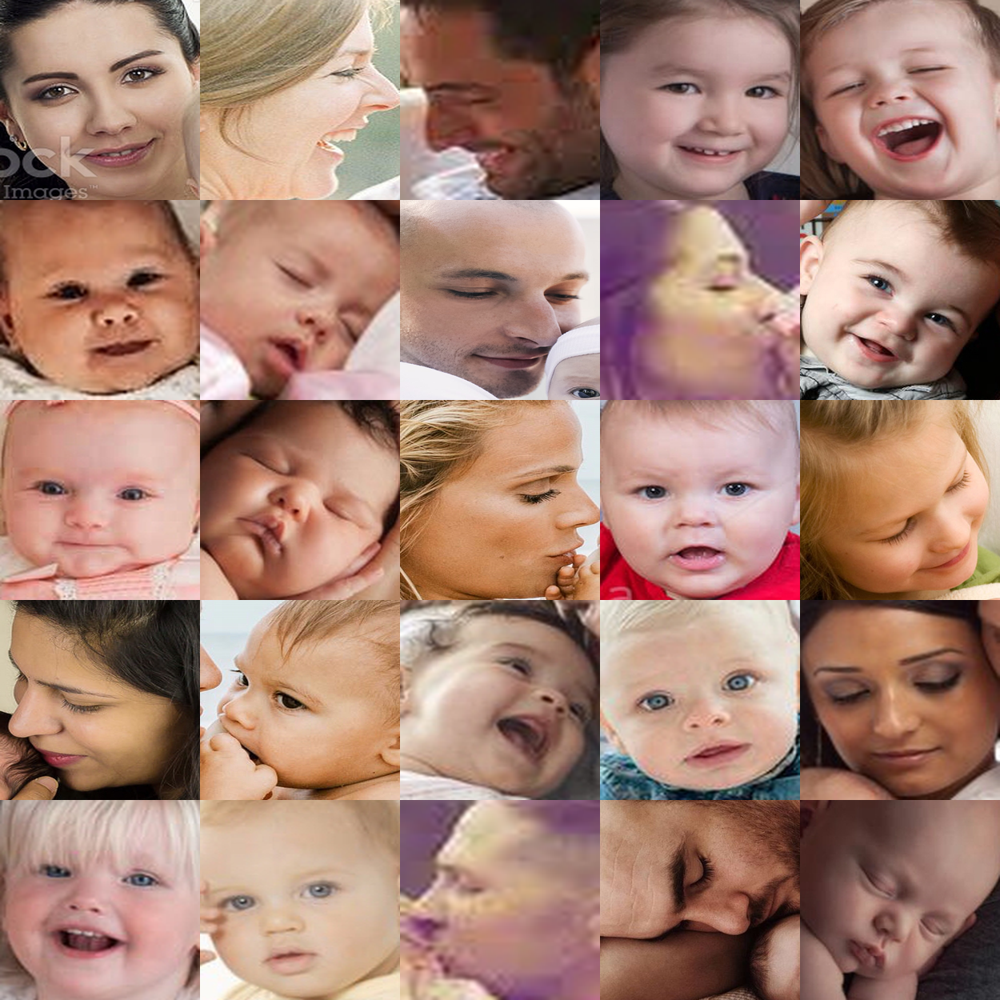

In [59]:
faces = [f'{FACES_PATH}/{f}' for f in os.listdir(FACES_PATH) if os.path.isfile(os.path.join(FACES_PATH, f))]
display = random.sample(faces, min(len(faces), 25))
display_images(display)

It is very obvious that this model does perform extremely well.

We can see that it can detect faces even if they are not straight and that the faces area it detects is relatively big enough to include most of the facial characteristics in the cropped image.

Furthermore, the number of faces detected is really high, outperforming all of the previously tested face detectors.

However, in contrast to YOLOFace it does not detect faces that are upside-down.

# Results

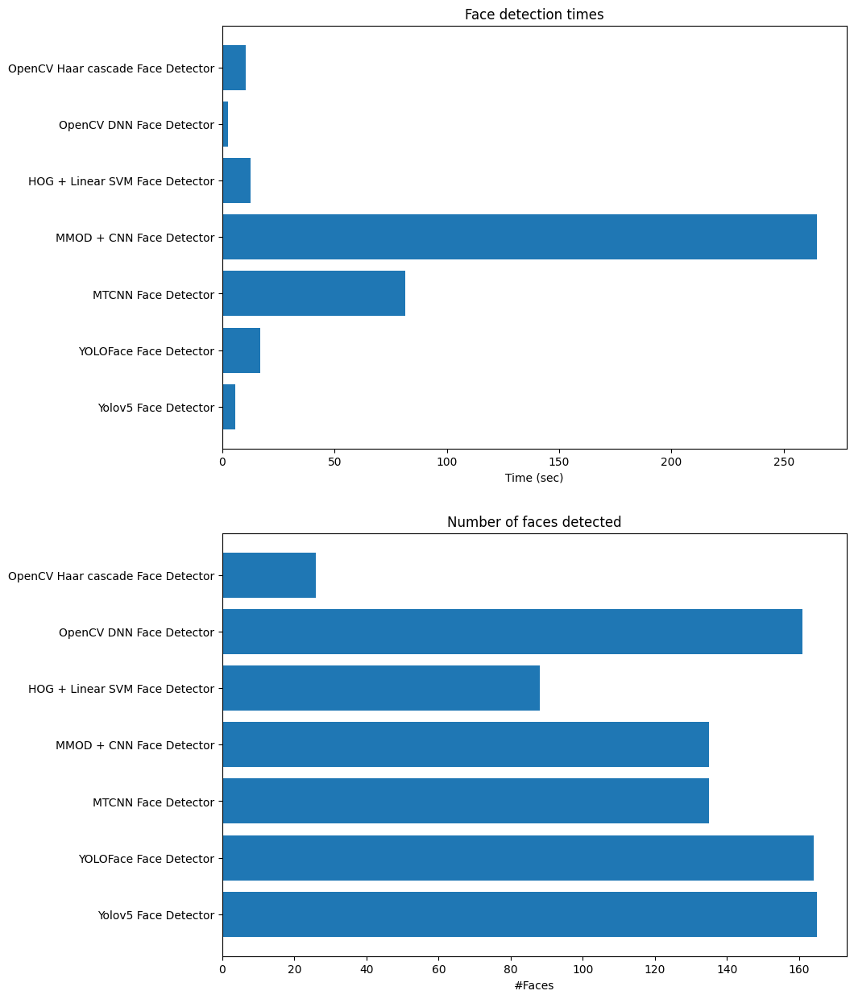

In [60]:
import matplotlib.pyplot as plt

%matplotlib inline

plt.rcdefaults()

fig, ax = plt.subplots(2, 1, figsize=[10,15])

y_pos = np.arange(len(detector_names)).tolist()

ax[0].barh(y_pos, detection_times, align='center')
ax[0].set_yticks(y_pos)
ax[0].set_yticklabels(detector_names)
ax[0].invert_yaxis()
ax[0].set_xlabel('Time (sec)')
ax[0].set_title('Face detection times')

ax[1].barh(y_pos, face_counts, align='center')
ax[1].set_yticks(y_pos)
ax[1].set_yticklabels(detector_names)
ax[1].invert_yaxis()
ax[1].set_xlabel('#Faces')
ax[1].set_title('Number of faces detected')

plt.show()